In [60]:
import dabl

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

## Load data

In [61]:
df = pd.read_csv("case_data_set.csv", sep=";")
df

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,"29,85","29,85",No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,"56,95","1889,5",No
2,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),"42,3","1840,75",No
3,1452-KIOVK,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,...,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),"89,1","1949,4",No
4,6713-OKOMC,Female,0,No,No,10,No,No phone service,DSL,Yes,...,No,No,No,No,Month-to-month,No,Mailed check,"29,75","301,9",No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,9378-FXTIZ,Female,0,Yes,No,54,Yes,Yes,DSL,No,...,No,No,Yes,Yes,One year,Yes,Credit card (automatic),"70,15","3715,65",Yes
5370,6993-OHLXR,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,No,Electronic check,"68,95","119,75",Yes
5371,7547-EKNFS,Male,0,Yes,No,42,Yes,Yes,Fiber optic,No,...,Yes,No,Yes,No,Month-to-month,Yes,Bank transfer (automatic),"95,25","3959,35",Yes
5372,1596-BBVTG,Male,0,No,No,35,Yes,Yes,Fiber optic,No,...,No,No,No,No,Month-to-month,No,Credit card (automatic),"75,35","2636,05",Yes


We can not use CustumerID, so we remove it

In [62]:
df = df.drop("customerID", axis=1)

## Manage NAN

### Which columns have NAN

In [63]:
df.isna().sum()

gender               0
SeniorCitizen        0
Partner              0
Dependents           0
tenure               0
PhoneService         0
MultipleLines        0
InternetService      0
OnlineSecurity       0
OnlineBackup         0
DeviceProtection     0
TechSupport          0
StreamingTV          0
StreamingMovies      0
Contract             0
PaperlessBilling     0
PaymentMethod        0
MonthlyCharges       0
TotalCharges        11
Churn                0
dtype: int64

In [64]:
df[df["TotalCharges"].isna()]

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
365,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,No,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),"52,55",NaN,No
569,Male,0,No,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"20,25",NaN,No
699,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,Yes,Yes,No,Yes,Yes,Two year,No,Mailed check,"80,85",NaN,No
798,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"25,75",NaN,No
987,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,Yes,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),"56,05",NaN,No
2462,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"19,85",NaN,No
2818,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"25,35",NaN,No
3235,Female,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20,NaN,No
3850,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,"19,7",NaN,No
4903,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,Yes,Yes,Yes,Yes,No,Two year,No,Mailed check,"73,35",NaN,No


In [65]:
df[df["tenure"]==0]

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
365,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,No,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),"52,55",NaN,No
569,Male,0,No,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"20,25",NaN,No
699,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,Yes,Yes,No,Yes,Yes,Two year,No,Mailed check,"80,85",NaN,No
798,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"25,75",NaN,No
987,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,Yes,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),"56,05",NaN,No
2462,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"19,85",NaN,No
2818,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"25,35",NaN,No
3235,Female,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20,NaN,No
3850,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,"19,7",NaN,No
4903,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,Yes,Yes,Yes,Yes,No,Two year,No,Mailed check,"73,35",NaN,No


In [66]:
df.loc[df["TotalCharges"].isna(),["TotalCharges"]] = '0'

Only TotalCharges has NAN.

It seems related to the fact that the customers have been with the company for less than 1 month.

We replaced the NAN with 0s.

In [67]:
df.isna().sum()

gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [68]:
df[df["tenure"]==0]

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
365,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,No,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),"52,55",0,No
569,Male,0,No,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"20,25",0,No
699,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,Yes,Yes,No,Yes,Yes,Two year,No,Mailed check,"80,85",0,No
798,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"25,75",0,No
987,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,Yes,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),"56,05",0,No
2462,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"19,85",0,No
2818,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,"25,35",0,No
3235,Female,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20,0,No
3850,Male,0,Yes,Yes,0,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,"19,7",0,No
4903,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,Yes,Yes,Yes,Yes,No,Two year,No,Mailed check,"73,35",0,No


## Manage data types

In [69]:
df.dtypes

gender              object
SeniorCitizen        int64
Partner             object
Dependents          object
tenure               int64
PhoneService        object
MultipleLines       object
InternetService     object
OnlineSecurity      object
OnlineBackup        object
DeviceProtection    object
TechSupport         object
StreamingTV         object
StreamingMovies     object
Contract            object
PaperlessBilling    object
PaymentMethod       object
MonthlyCharges      object
TotalCharges        object
Churn               object
dtype: object

In [70]:
dabl.clean(df, verbose=1)

Detected feature types:
continuous       1
dirty_float      0
low_card_int     0
categorical     16
date             0
free_string      2
useless          1
dtype: int64


,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,"29,85","29,85"
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,"56,95","1889,5"
2,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),"42,3","1840,75"
3,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),"89,1","1949,4"
4,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,"29,75","301,9"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,Female,0,Yes,No,54,Yes,Yes,DSL,No,No,No,No,Yes,Yes,One year,Yes,Credit card (automatic),"70,15","3715,65"
5370,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Electronic check,"68,95","119,75"
5371,Male,0,Yes,No,42,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,No,Month-to-month,Yes,Bank transfer (automatic),"95,25","3959,35"
5372,Male,0,No,No,35,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Credit card (automatic),"75,35","2636,05"


In [71]:
dabl.detect_types(df)

,continuous,dirty_float,low_card_int,categorical,date,free_string,useless
gender,False,False,False,True,False,False,False
SeniorCitizen,False,False,False,True,False,False,False
Partner,False,False,False,True,False,False,False
Dependents,False,False,False,True,False,False,False
tenure,True,False,False,False,False,False,False
PhoneService,False,False,False,True,False,False,False
MultipleLines,False,False,False,True,False,False,False
InternetService,False,False,False,True,False,False,False
OnlineSecurity,False,False,False,True,False,False,False
OnlineBackup,False,False,False,True,False,False,False


Both Charges are objects. They should be transfered to floats. First need to chage comas to points.

In [72]:
for col in ["MonthlyCharges", "TotalCharges"]:
    df[col] = df[col].apply(lambda x: x.replace(",", "."))
    df = df.astype({col: float})
df

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
3,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.10,1949.40,No
4,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.90,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,Female,0,Yes,No,54,Yes,Yes,DSL,No,No,No,No,Yes,Yes,One year,Yes,Credit card (automatic),70.15,3715.65,Yes
5370,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Electronic check,68.95,119.75,Yes
5371,Male,0,Yes,No,42,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,No,Month-to-month,Yes,Bank transfer (automatic),95.25,3959.35,Yes
5372,Male,0,No,No,35,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Credit card (automatic),75.35,2636.05,Yes


In [73]:
df.dtypes

gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges        float64
Churn                object
dtype: object

## Study and vizualisation of data

In [97]:
print(' Churn No Ratio: ', round(df['Churn'].value_counts()[0]/df.shape[0] ,2), '\n', 
      'Churn Yes Ratio: ', round(df['Churn'].value_counts()[1]/df.shape[0] ,2))

 Churn No Ratio:  0.96 
 Churn Yes Ratio:  0.04


Target looks like classification
Linear Discriminant Analysis training set score: 0.507


/Users/nicholas/KapacityTest/KapacityTest_env/lib/python3.8/site-packages/dabl/plot/utils.py:374: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(


[[<Figure size 648x648 with 12 Axes>,
  <Figure size 1152x288 with 4 Axes>,
  <Figure size 432x288 with 1 Axes>],
 None]

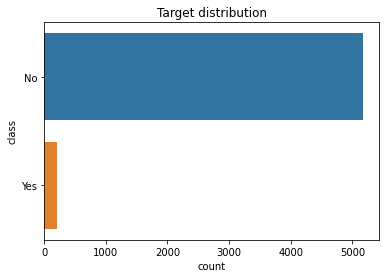

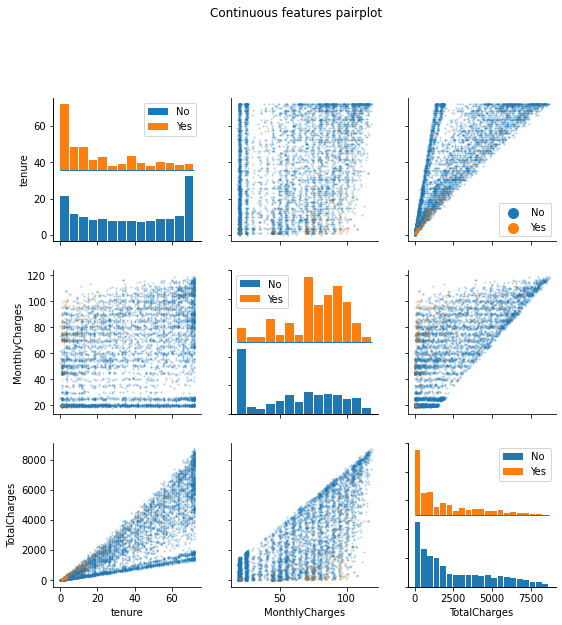

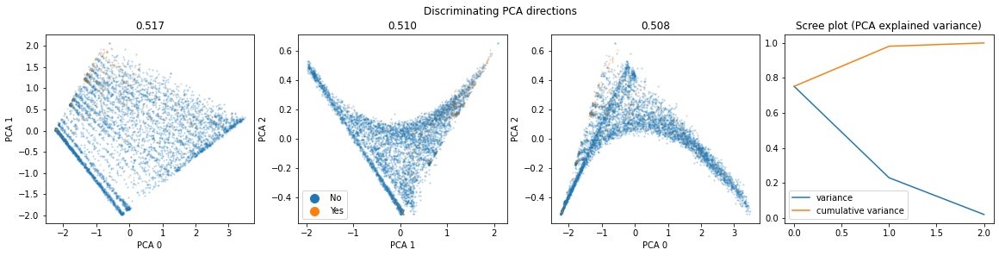

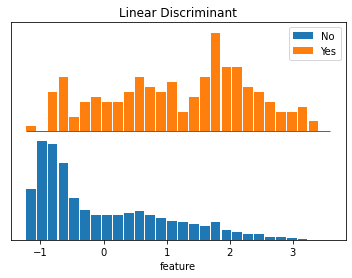

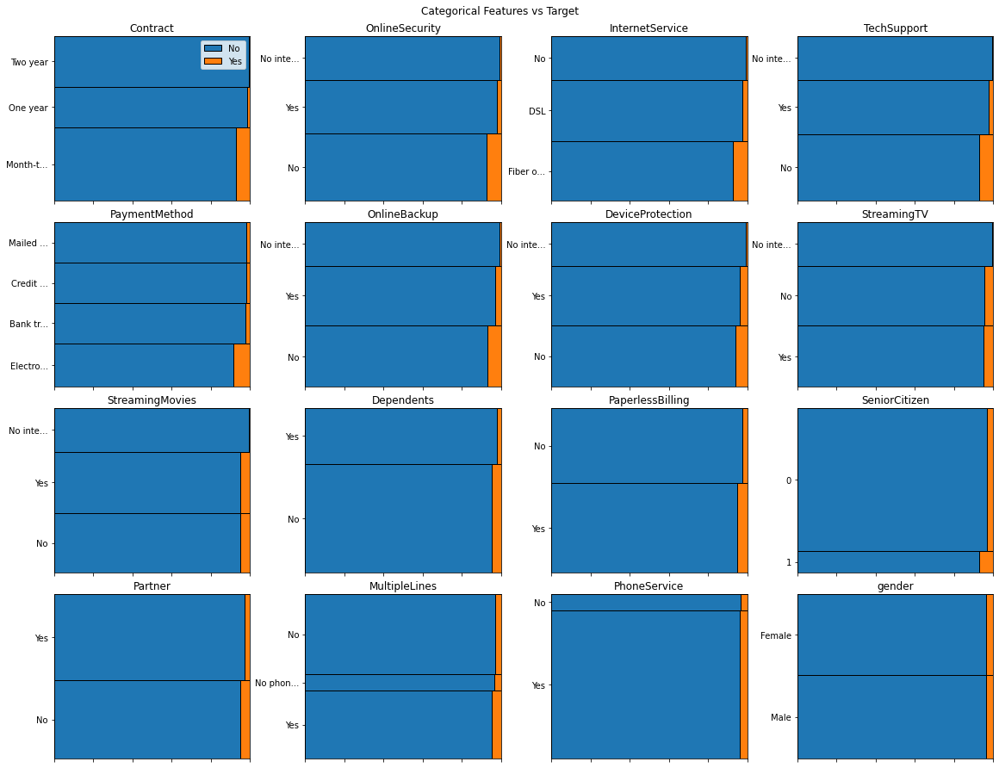

In [50]:
dabl.plot(df, target_col="Churn")

In [124]:
df_num_ser = df.copy()

In [125]:
df_num_ser

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
3,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.10,1949.40,No
4,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.90,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,Female,0,Yes,No,54,Yes,Yes,DSL,No,No,No,No,Yes,Yes,One year,Yes,Credit card (automatic),70.15,3715.65,Yes
5370,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Electronic check,68.95,119.75,Yes
5371,Male,0,Yes,No,42,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,No,Month-to-month,Yes,Bank transfer (automatic),95.25,3959.35,Yes
5372,Male,0,No,No,35,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Credit card (automatic),75.35,2636.05,Yes


In [126]:
# Creating a column with sum of services. First transform data to service or not.
services = ['PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity',
            'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies']
for col in services:
    df_num_ser[col+"_01"] = df_num_ser[col].apply(lambda x: np.where('No' in x, 0, 1))


In [127]:
services_01 = [service+"_01" for service in services]
df_num_ser["SumServices"] = df_num_ser[services_01].sum(axis = 1)
df_num_ser

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,...,PhoneService_01,MultipleLines_01,InternetService_01,OnlineSecurity_01,OnlineBackup_01,DeviceProtection_01,TechSupport_01,StreamingTV_01,StreamingMovies_01,SumServices
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,...,0,0,1,0,1,0,0,0,0,2
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,...,1,0,1,1,0,1,0,0,0,4
2,Male,0,No,No,45,No,No phone service,DSL,Yes,No,...,0,0,1,1,0,1,1,0,0,4
3,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,...,1,1,1,0,1,0,0,1,0,5
4,Female,0,No,No,10,No,No phone service,DSL,Yes,No,...,0,0,1,1,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,Female,0,Yes,No,54,Yes,Yes,DSL,No,No,...,1,1,1,0,0,0,0,1,1,5
5370,Female,0,No,No,2,Yes,No,Fiber optic,No,No,...,1,0,1,0,0,0,0,0,0,2
5371,Male,0,Yes,No,42,Yes,Yes,Fiber optic,No,Yes,...,1,1,1,0,1,1,0,1,0,6
5372,Male,0,No,No,35,Yes,Yes,Fiber optic,No,No,...,1,1,1,0,0,0,0,0,0,3


Target looks like classification
Linear Discriminant Analysis training set score: 0.500


/Users/nicholas/KapacityTest/KapacityTest_env/lib/python3.8/site-packages/dabl/plot/utils.py:374: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(


[[<Figure size 864x864 with 20 Axes>,
  <Figure size 1152x288 with 4 Axes>,
  <Figure size 432x288 with 1 Axes>],
 None]

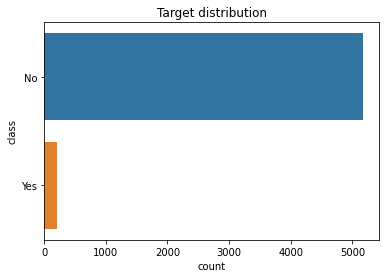

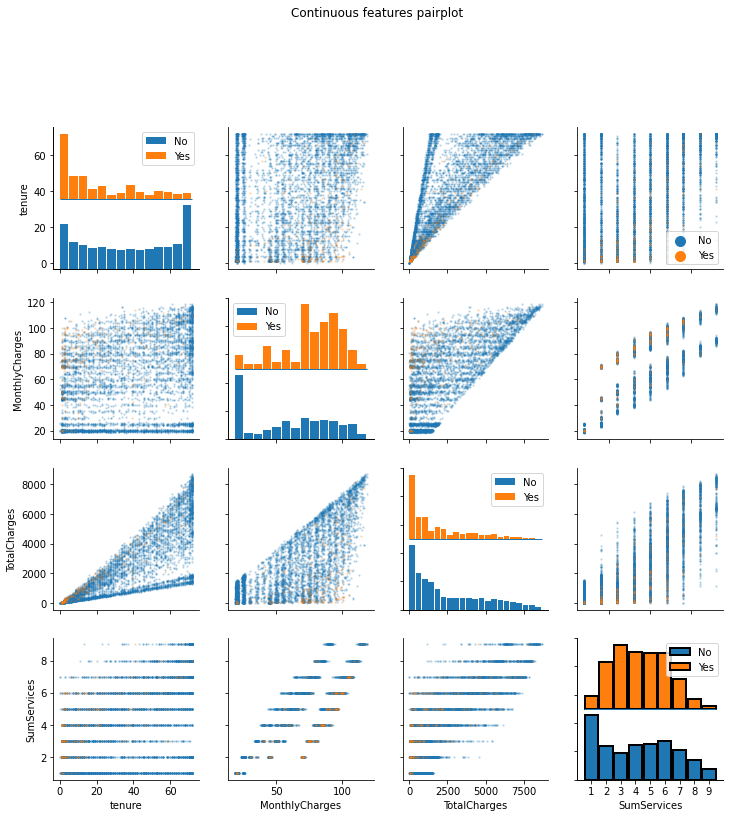

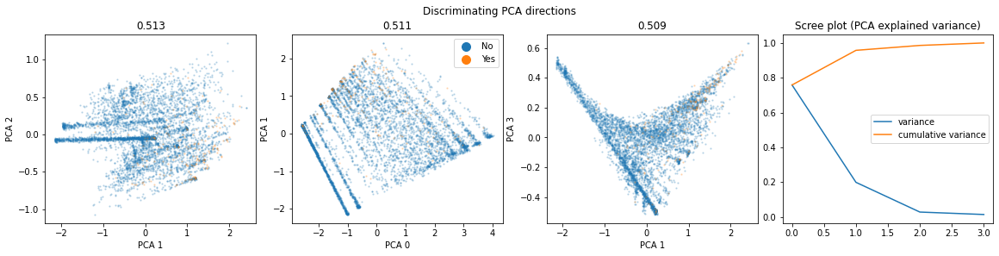

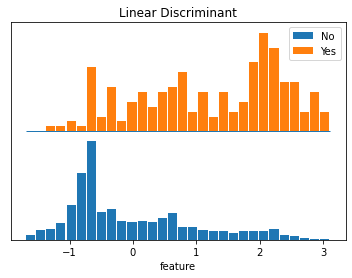

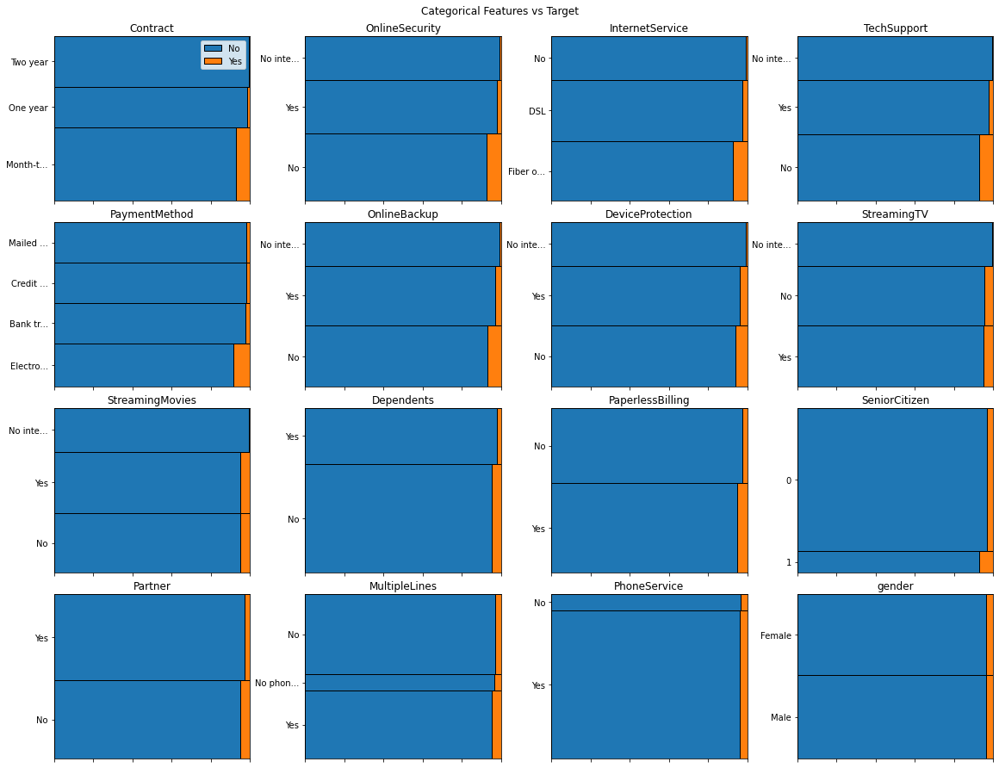

In [128]:
dabl.plot(df_num_ser.drop(services_01, axis =1), target_col="Churn")

## What they think

In [130]:
churn_to_citizen = df_num_ser.groupby(['Churn', 'SumServices']).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['SumServices', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen

,SumServices,Churn_0,Churn_1,Churn_Ratio
0,1,1126,8,0.705467
1,2,593,28,4.508857
2,3,466,38,7.539683
3,4,613,34,5.255023
4,5,633,33,4.954955
5,6,676,33,4.654443
6,7,524,18,3.321033
7,8,346,6,1.704545
8,9,197,2,1.005025


In [134]:
df_num_ser['MonhlyCharges_segment'] = pd.cut(df_num_ser['MonthlyCharges'], 3, 
                                 labels=['Low', 'Medium', 'High']).astype('O')

In [137]:
churn_to_citizen = df_num_ser.groupby(['Churn', "MonhlyCharges_segment"]).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['MonhlyCharges_segment', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen.sort_values('Churn_Ratio', ascending=False)

,MonhlyCharges_segment,Churn_0,Churn_1,Churn_Ratio
0,High,1429,85,5.614267
2,Medium,1697,84,4.716451
1,Low,2048,31,1.491101


## Better options

In [138]:
df_num_ser['tenure_segment'] = pd.cut(df_num_ser['tenure'], 3, 
                                 labels=['Low', 'Medium', 'High']).astype('O')

In [139]:
churn_to_citizen = df_num_ser.groupby(['Churn', "tenure_segment"]).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['tenure_segment', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen.sort_values('Churn_Ratio', ascending=False)

,tenure_segment,Churn_0,Churn_1,Churn_Ratio
1,Low,1879,138,6.841844
2,Medium,1269,35,2.684049
0,High,2026,27,1.315149


In [142]:
churn_to_citizen = df_num_ser.groupby(['Churn', 'Contract']).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['Contract', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen.sort_values('Churn_Ratio', ascending=False)

,Contract,Churn_0,Churn_1,Churn_Ratio
0,Month-to-month,2220,173,7.229419
1,One year,1307,20,1.507159
2,Two year,1647,7,0.423216


In [143]:
churn_to_citizen = df_num_ser.groupby(['Churn', 'InternetService']).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['InternetService', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen.sort_values('Churn_Ratio', ascending=False)

,InternetService,Churn_0,Churn_1,Churn_Ratio
1,Fiber optic,1799,145,7.458848
0,DSL,1962,47,2.339472
2,No,1413,8,0.562984


In [144]:
churn_to_citizen = df_num_ser.groupby(['Churn', 'SeniorCitizen']).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['SeniorCitizen', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen.sort_values('Churn_Ratio', ascending=False)

,SeniorCitizen,Churn_0,Churn_1,Churn_Ratio
1,1,666,50,6.983240
0,0,4508,150,3.220266


In [145]:
churn_to_citizen = df_num_ser.groupby(['Churn', 'PaymentMethod']).agg({'Churn':'count'}).unstack().T.reset_index().drop('level_0', axis=1)
churn_to_citizen.columns = ['PaymentMethod', 'Churn_0', 'Churn_1']
churn_to_citizen['Churn_Ratio'] = churn_to_citizen['Churn_1']*100 /(churn_to_citizen['Churn_0'] + churn_to_citizen['Churn_1'])
churn_to_citizen.sort_values('Churn_Ratio', ascending=False)

,PaymentMethod,Churn_0,Churn_1,Churn_Ratio
2,Electronic check,1294,121,8.551237
0,Bank transfer (automatic),1286,29,2.205323
1,Credit card (automatic),1290,25,1.901141
3,Mailed check,1304,25,1.881114


In [51]:
simple_classifier = dabl.SimpleClassifier(random_state=42).fit(df, target_col="Churn")

Running DummyClassifier()
accuracy: 0.963 average_precision: 0.037 roc_auc: 0.500 recall_macro: 0.500 f1_macro: 0.491
=== new best DummyClassifier() (using recall_macro):
accuracy: 0.963 average_precision: 0.037 roc_auc: 0.500 recall_macro: 0.500 f1_macro: 0.491

Running GaussianNB()
accuracy: 0.652 average_precision: 0.162 roc_auc: 0.815 recall_macro: 0.737 f1_macro: 0.466
=== new best GaussianNB() (using recall_macro):
accuracy: 0.652 average_precision: 0.162 roc_auc: 0.815 recall_macro: 0.737 f1_macro: 0.466

Running MultinomialNB()
accuracy: 0.837 average_precision: 0.168 roc_auc: 0.818 recall_macro: 0.733 f1_macro: 0.565
Running DecisionTreeClassifier(class_weight='balanced', max_depth=1)
accuracy: 0.582 average_precision: 0.068 roc_auc: 0.718 recall_macro: 0.718 f1_macro: 0.429
Running DecisionTreeClassifier(class_weight='balanced', max_depth=5)
accuracy: 0.716 average_precision: 0.131 roc_auc: 0.764 recall_macro: 0.708 f1_macro: 0.492
Running DecisionTreeClassifier(class_weight=

In [53]:
def grab_cols(dataframe, cat_th=10, car_th=20):
    cat_cols = [col for col in dataframe.columns  # Categorical
                if dataframe[col].dtypes == "O"]
    num_but_cat = [col for col in dataframe.columns
                   if dataframe[col].nunique() < cat_th and  # Numeric but categorical
                   dataframe[col].dtypes != "O"]
    cat_but_car = [col for col in dataframe.columns
                   if dataframe[col].nunique() > car_th and  # Categorical but high cardinal
                   dataframe[col].dtypes == "O"]
    num_cols = [col for col in dataframe.columns if dataframe[col].dtypes not in ['O', 'datetime64[ns]'] and
                dataframe[col].nunique() > 10]  # Numeric
    return cat_cols, num_but_cat, cat_but_car, num_cols

In [54]:
cat_cols, num_but_cat, cat_but_car, num_cols = grab_cols(df)

In [75]:
num_cols

['tenure', 'MonthlyCharges', 'TotalCharges']

In [76]:
cat_cols

['gender',
 'Partner',
 'Dependents',
 'PhoneService',
 'MultipleLines',
 'InternetService',
 'OnlineSecurity',
 'OnlineBackup',
 'DeviceProtection',
 'TechSupport',
 'StreamingTV',
 'StreamingMovies',
 'Contract',
 'PaperlessBilling',
 'PaymentMethod',
 'Churn']

In [77]:
num_but_cat

['SeniorCitizen']

In [78]:
cat_but_car

[]

Making target 0-1 for corrolation study

In [55]:

df['Churn'] = np.where(df['Churn'] == 'Yes', 1, 0)

<AxesSubplot:>

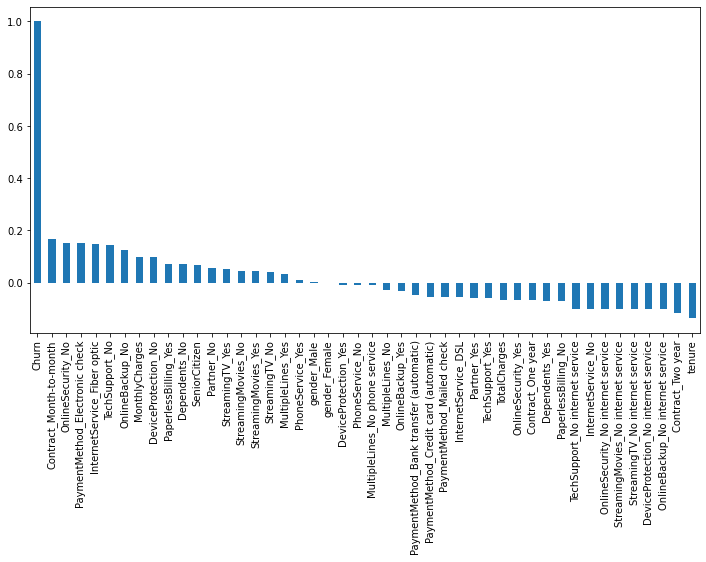

In [56]:
plt.figure(figsize=(12,6))
(pd.get_dummies(df).corr()['Churn']).sort_values(ascending=False).plot(kind='bar')

No single factor seems to be corrolated with more than 20%.

In [57]:
df

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,0
1,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,0
2,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,0
3,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.10,1949.40,0
4,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.90,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,Female,0,Yes,No,54,Yes,Yes,DSL,No,No,No,No,Yes,Yes,One year,Yes,Credit card (automatic),70.15,3715.65,1
5370,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Electronic check,68.95,119.75,1
5371,Male,0,Yes,No,42,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,No,Month-to-month,Yes,Bank transfer (automatic),95.25,3959.35,1
5372,Male,0,No,No,35,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,No,Credit card (automatic),75.35,2636.05,1


In [74]:
df.dtypes

gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges        float64
Churn                object
dtype: object

In [79]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

In [83]:
def prepro(df, drop_cols=[], num_cols=[]):
    """Remove cols, dummies, standardize"""

    df = df.drop(drop_cols, axis=1)
    df = pd.get_dummies(df)
    df[num_cols] = scaler.fit_transform(df[num_cols])
    
    return df

In [84]:
X = prepro(df.drop("Churn", axis=1), [], num_cols)
y = df["Churn"]

In [85]:
X

,SeniorCitizen,tenure,MonthlyCharges,TotalCharges,gender_Female,gender_Male,Partner_No,Partner_Yes,Dependents_No,Dependents_Yes,...,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaperlessBilling_No,PaperlessBilling_Yes,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,0,-1.484116,-1.034367,-1.072278,1,0,0,1,1,0,...,0,1,0,0,0,1,0,0,1,0
1,0,-0.120914,-0.159061,-0.271538,0,1,1,0,1,0,...,0,0,1,0,1,0,0,0,0,1
2,0,0.333486,-0.632243,-0.292529,0,1,1,0,1,0,...,0,0,1,0,1,0,1,0,0,0
3,0,-0.616624,0.879357,-0.245745,0,1,1,0,0,1,...,0,1,0,0,0,1,0,1,0,0
4,0,-1.112334,-1.037597,-0.955137,1,0,1,0,1,0,...,0,1,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,0,0.705269,0.267288,0.514778,1,0,0,1,1,0,...,1,0,1,0,0,1,0,1,0,0
5370,0,-1.442807,0.228529,-1.033569,1,0,1,0,1,0,...,0,1,0,0,1,0,0,0,1,0
5371,0,0.209559,1.077996,0.619712,0,1,0,1,1,0,...,0,1,0,0,0,1,1,0,0,0
5372,0,-0.079605,0.435243,0.049917,0,1,1,0,1,0,...,0,1,0,0,1,0,0,1,0,0


In [86]:
X.columns

Index(['SeniorCitizen', 'tenure', 'MonthlyCharges', 'TotalCharges',
       'gender_Female', 'gender_Male', 'Partner_No', 'Partner_Yes',
       'Dependents_No', 'Dependents_Yes', 'PhoneService_No',
       'PhoneService_Yes', 'MultipleLines_No',
       'MultipleLines_No phone service', 'MultipleLines_Yes',
       'InternetService_DSL', 'InternetService_Fiber optic',
       'InternetService_No', 'OnlineSecurity_No',
       'OnlineSecurity_No internet service', 'OnlineSecurity_Yes',
       'OnlineBackup_No', 'OnlineBackup_No internet service',
       'OnlineBackup_Yes', 'DeviceProtection_No',
       'DeviceProtection_No internet service', 'DeviceProtection_Yes',
       'TechSupport_No', 'TechSupport_No internet service', 'TechSupport_Yes',
       'StreamingTV_No', 'StreamingTV_No internet service', 'StreamingTV_Yes',
       'StreamingMovies_No', 'StreamingMovies_No internet service',
       'StreamingMovies_Yes', 'Contract_Month-to-month', 'Contract_One year',
       'Contract_Two year', '

Remove columns with 'No phone service' or 'No internet service' as they are duplicate from colums specifically asking this. 

In [90]:
cols_dup = []
for col in X.columns:
    if "No phone service" in col:
        cols_dup.append(col)
    elif "No internet service" in col:
        cols_dup.append(col)
cols_dup

['MultipleLines_No phone service',
 'OnlineSecurity_No internet service',
 'OnlineBackup_No internet service',
 'DeviceProtection_No internet service',
 'TechSupport_No internet service',
 'StreamingTV_No internet service',
 'StreamingMovies_No internet service']

In [91]:
X = X.drop(cols_dup, axis = 1)
X

,SeniorCitizen,tenure,MonthlyCharges,TotalCharges,gender_Female,gender_Male,Partner_No,Partner_Yes,Dependents_No,Dependents_Yes,...,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaperlessBilling_No,PaperlessBilling_Yes,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,0,-1.484116,-1.034367,-1.072278,1,0,0,1,1,0,...,0,1,0,0,0,1,0,0,1,0
1,0,-0.120914,-0.159061,-0.271538,0,1,1,0,1,0,...,0,0,1,0,1,0,0,0,0,1
2,0,0.333486,-0.632243,-0.292529,0,1,1,0,1,0,...,0,0,1,0,1,0,1,0,0,0
3,0,-0.616624,0.879357,-0.245745,0,1,1,0,0,1,...,0,1,0,0,0,1,0,1,0,0
4,0,-1.112334,-1.037597,-0.955137,1,0,1,0,1,0,...,0,1,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5369,0,0.705269,0.267288,0.514778,1,0,0,1,1,0,...,1,0,1,0,0,1,0,1,0,0
5370,0,-1.442807,0.228529,-1.033569,1,0,1,0,1,0,...,0,1,0,0,1,0,0,0,1,0
5371,0,0.209559,1.077996,0.619712,0,1,0,1,1,0,...,0,1,0,0,0,1,1,0,0,0
5372,0,-0.079605,0.435243,0.049917,0,1,1,0,1,0,...,0,1,0,0,1,0,0,1,0,0


In [92]:
y

0        No
1        No
2        No
3        No
4        No
       ... 
5369    Yes
5370    Yes
5371    Yes
5372    Yes
5373    Yes
Name: Churn, Length: 5374, dtype: object

In [95]:
X.to_csv("X.csv", index=False)

In [96]:
y.to_csv("y.csv", index=False)